In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from sentence_transformers import SentenceTransformer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.mixture import GaussianMixture

import boto3

C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sentence_transformers\cross_encoder\CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange


# public data: https://www.kaggle.com/datasets/maharshipandya/-spotify-tracks-dataset
# personal data: spotify API

In [4]:
def read_full_table(table_name):
    session = boto3.Session(profile_name="default")
    dynamodb = session.resource("dynamodb", region_name="eu-west-1")
    table = dynamodb.Table(table_name)
    response = table.scan()
    data = response["Items"]

    # Handle pagination
    while "LastEvaluatedKey" in response:
        response = table.scan(ExclusiveStartKey=response["LastEvaluatedKey"])
        data.extend(response["Items"])
        
    return pd.DataFrame(data)

In [5]:
numerical_cols = ["num_sections", "danceability", "sections_avg_duration", "instrumentalness", "liveness", "loudness",
                  "duration", "speechiness", "valence", "dynamics_changes", "tempo_changes", "acousticness",
                  "time_signature_changes", "popularity", "mode_changes", "energy", "key_changes", "tempo"]
numerical_cols_public = ["danceability", "instrumentalness", "liveness", "loudness", "duration", "speechiness", 
                         "valence", "acousticness", "popularity", "energy", "tempo"]

non_standarized_cols = ["num_sections", "sections_avg_duration", "loudness", "duration", "dynamics_changes", 
                         "tempo_changes", "time_signature_changes", "popularity", "mode_changes", "key_changes", "tempo"]
categorical_cols = ["key", "mode"]

notes = ("C", "C#", "D", "Eb", "E", "F", "F#", "G", "Ab", "A", "Bb", "B")
key_mapping = {i:note for i, note in enumerate(notes)}
key_mapping[-1] = "NoKey"

mode_mapping = {0: "Minor", 1: "Major"}

random_state = 602452

# Preprocess

In [6]:
top_artists_raw = read_full_table("top_artists")
recently_played_raw = read_full_table("recently_played")
track_info_raw = read_full_table("track_info")
public_data_raw = pd.read_csv(r"C:\Users\jcf\Desktop\codigo\Portfolio\Spotify Analysis\public_music_data.csv")

In [7]:
top_artists = top_artists_raw.copy()
recently_played = recently_played_raw.copy()
track_info = track_info_raw.copy()
public_data = public_data_raw.copy()

In [8]:
track_info["key"] = track_info["key"].map(key_mapping)
track_info["mode"] = track_info["mode"].map(mode_mapping)

public_data["key"] = public_data["key"].map(key_mapping)
public_data["mode"] = public_data["mode"].map(mode_mapping)

In [9]:
for col in numerical_cols:
    track_info[col] = pd.to_numeric(track_info[col])
    
for col in track_info.columns:
    if "changes" in col:
        track_info[col] = track_info[col] / track_info["duration"]

track_info["case"] = "user"

public_data["duration"] = public_data["duration_ms"] / 1000
public_data["case"] = "public"

genre_info = track_info.explode("genres")
genre_info = genre_info.loc[:, ["genres", "track_id", "artist"]]
genre_info = genre_info.groupby(["genres"]).nunique().reset_index()
genre_info["track_perc"] = 100 * genre_info["track_id"] / genre_info["track_id"].sum()
genre_info["artist_perc"] = 100 * genre_info["artist"] / genre_info["artist"].sum()

genre_info_public = public_data.loc[:, ["track_genre", "track_id", "artists"]]
genre_info_public = genre_info_public.groupby(["track_genre"]).nunique().reset_index()
genre_info_public["track_perc"] = 100 * genre_info_public["track_id"] / genre_info_public["track_id"].sum()
genre_info_public["artist_perc"] = 100 * genre_info_public["artists"] / genre_info_public["artists"].sum()

In [8]:
# genre_info = track_info.genres


In [8]:
# public_data

# do analysis (numerical and plots)
'track_name', 'album', 'artist', 'track_id', 'raw_sections'

'num_sections', 'danceability',  'sections_avg_duration',
'instrumentalness', 'liveness', 'loudness', 'duration', 'speechiness',
'valence', 'dynamics_changes', 'mode', 'tempo_changes',
'acousticness', 'time_signature_changes',
'popularity', 'mode_changes', 'energy', 'key_changes', 'key',
'tempo', 'explicit'

# show top artists and recenelty played in table

# plots: 
    X - histograma features canciones -> here/tableau
    X - histograma generos -> here
    X - correlaciones entre features -> here
    X - clustering usuario (y public?) -> here
    - predictor de genero con features (train con public, test con usuario. comparar con clusters de antes)
    X - comparativas usuario y public -> here
    
    -try to replicate them in tableau


# model:
# try to group more the genres (manually? semantic comparison?) -> to reduce the total 
# clustering kmeans usuario (standarize first)
# modelo predictor genero (?)

In [8]:
for row in track_info.genres.sample(5):
    print(row)

['art rock', 'instrumental rock', 'jazz rock', 'progressive rock', 'psychedelic rock', 'symphonic rock', 'zolo']
['alternative metal', 'hard rock', 'melodic thrash', 'metal', 'old school thrash', 'rock', 'speed metal', 'thrash metal']
['album rock', 'canadian metal', 'classic canadian rock', 'classic rock', 'hard rock', 'progressive rock', 'rock']
['australian psych', 'double drumming', 'microtonal', 'neo-psychedelic']
['progressive metal']


# Clustering

## EDA

total_elements=241, top_elements=83


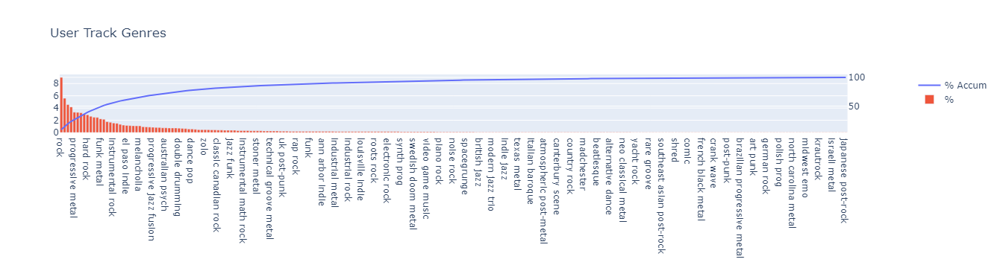

total_elements=241, top_elements=170


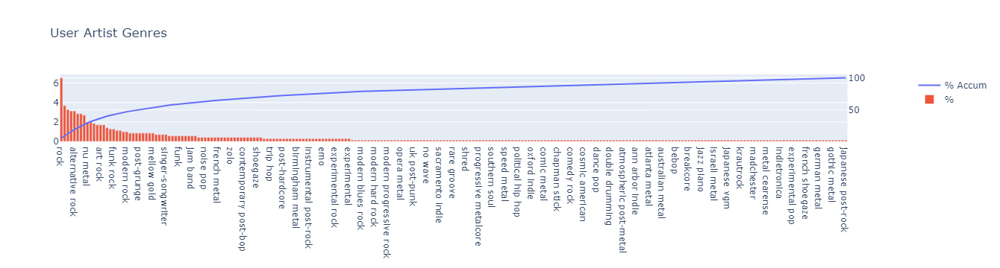

In [9]:
for element in ("track", "artist"):
    genre_info_plot = genre_info.sort_values(by=f"{element}_perc", ascending=False)
    genre_info_plot[f"{element}_perc_accum"] = genre_info_plot[f"{element}_perc"].cumsum()
    
    total_elements = genre_info_plot["genres"].nunique()
    top_elements = genre_info_plot.loc[genre_info_plot[f"{element}_perc_accum"] <= 90, "genres"].nunique()
    
    print(f"{total_elements=}, {top_elements=}")

    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(
        go.Scatter(x=genre_info_plot["genres"], y=genre_info_plot[f"{element}_perc_accum"], name="% Accum"),
        secondary_y=True,
    )
    fig.add_trace(
        go.Bar(x=genre_info_plot["genres"], y=genre_info_plot[f"{element}_perc"], name="%"),
        secondary_y=False,
    )
    fig.update_layout(
        title_text=f"User {element.capitalize()} Genres"
    )

    fig.show()

In [12]:
# px.bar(genre_info.sort_values(by="artist_perc", ascending=False), x="genres", y="artist_perc", title="User Artist Genres")

In [13]:
# px.bar(genre_info_public.sort_values(by="track_id", ascending=False), x="track_genre", y="track_id")

total_elements=114, top_elements=102


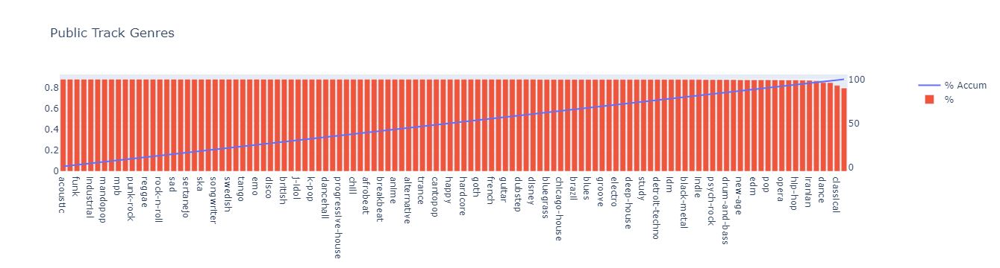

total_elements=114, top_elements=91


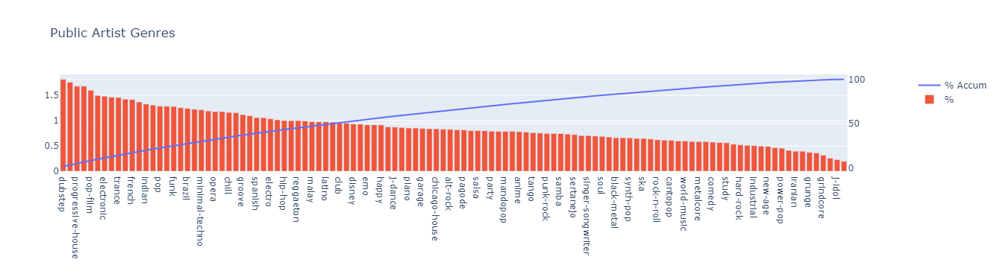

In [10]:
# px.bar(genre_info_public.sort_values(by="artists", ascending=False), x="track_genre", y="artists")
for element in ("track", "artist"):
    genre_info_plot = genre_info_public.sort_values(by=f"{element}_perc", ascending=False)
    genre_info_plot[f"{element}_perc_accum"] = genre_info_plot[f"{element}_perc"].cumsum()
    
    total_elements = genre_info_plot["track_genre"].nunique()
    top_elements = genre_info_plot.loc[genre_info_plot[f"{element}_perc_accum"] <= 90, "track_genre"].nunique()
    
    print(f"{total_elements=}, {top_elements=}")

    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(
        go.Scatter(x=genre_info_plot["track_genre"], y=genre_info_plot[f"{element}_perc_accum"], name="% Accum"),
        secondary_y=True,
    )
    fig.add_trace(
        go.Bar(x=genre_info_plot["track_genre"], y=genre_info_plot[f"{element}_perc"], name="%"),
        secondary_y=False,
    )
    fig.update_layout(
        title_text=f"Public {element.capitalize()} Genres"
    )

    fig.show()

In [11]:
public_genres = genre_info_public["track_genre"].unique()
user_genres = genre_info["genres"].unique()

user_genres_not_public = set(user_genres).difference(set(public_genres))
pulic_genres_not_user = set(public_genres).difference(set(user_genres))

print(f"{user_genres_not_public=}\n({len(user_genres_not_public)}, {100 * len(user_genres_not_public) / len(user_genres)}%)")
print(f"{pulic_genres_not_user=}\n({len(pulic_genres_not_user)}, {100 * len(pulic_genres_not_user) / len(public_genres)})%")

user_genres_not_public={'progressive death metal', 'breakcore', 'french death metal', 'new wave', 'microtonal', 'atmospheric sludge', 'opera metal', 'shimmer pop', 'soft rock', 'taiwan post-rock', 'louisville indie', 'country rock', 'uk post-punk', 'southeast asian post-rock', 'hard rock', 'german rock', 'conscious hip hop', 'post-metal', 'folk rock', 'shred', 'oxford indie', 'sludge metal', 'modern hard rock', 'electronic djent', 'electronica', 'garage rock', 'mexican classic rock', 'proto-metal', 'rap rock', 'instrumental bluegrass', 'modern progressive rock', 'p funk', 'anti-folk', 'israeli metal', 'sacramento indie', 'slacker rock', 'scottish rock', 'afrofuturism', 'electric blues', 'beatlesque', 'jazz metal', 'parody', 'otacore', 'american post-rock', 'krautrock', 'sillycore', 'stoner metal', 'jazz fusion', 'comic', 'late romantic era', 'brazilian progressive metal', 'melodic metalcore', 'australian metal', 'emotional black metal', 'noise pop', 'uk doom metal', 'supergroup', 'no w

## By genre text

In [12]:
genre_info_sorted = genre_info.sort_values(by=f"track_perc", ascending=False)
genre_info_sorted[f"track_perc_accum"] = genre_info_sorted[f"track_perc"].cumsum()

limit = 100

genre_info_sorted = genre_info_sorted.loc[genre_info_sorted[f"track_perc_accum"] <= limit, "genres"].unique()
genres =  genre_info_sorted.tolist()

model = SentenceTransformer('paraphrase-MiniLM-L6-v2')

embeddings = model.encode(genres)

param_grid = {
    "n_clusters": range(3, 15)
}
grid_search = GridSearchCV(
    KMeans(random_state=random_state), param_grid=param_grid
)
grid_search.fit(embeddings)

df = pd.DataFrame(grid_search.cv_results_)
num_clusters = df.loc[df["rank_test_score"] == 1, "param_n_clusters"].values[0]

print(f"Recommended number of clusters is {num_clusters}")

C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\huggingface_hub\file_download.py:1132: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.

C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning:

Could not find the number of physical cores for the following reason:
found 0 physical cores < 1
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.

  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\externals\loky\backend\context.py", line 282, in _count_physical_cores
    raise ValueError(f"found {cpu_count_physical} physical cores < 1")


Recommended number of clusters is 14


Cluster 0: rock, alternative rock, progressive rock, art rock, hard rock, classic rock, album rock, symphonic rock, modern rock, instrumental rock, psychedelic rock, garage rock, soft rock, classic canadian rock, stoner rock, indie rock, glam rock, acid rock, dance rock, industrial rock, post-rock, roots rock, folk rock, electronic rock, piano rock, modern progressive rock, noise rock, mexican classic rock, experimental rock, american post-rock, instrumental post-rock, italian progressive rock, flute rock, experimental indie rock, country rock, scottish rock, boston rock, modern alternative rock, slacker rock, taiwan post-rock, space rock, southeast asian post-rock, rock drums, german hard rock, comedy rock, acoustic rock, german rock, german stoner rock, modern hard rock, instrumental stoner rock, greek psychedelic rock

Cluster 1: funk rock, djent, instrumental funk, instrumental djent, shoegaze, p funk, funk, synth prog, electronic djent, synth funk, funktronica, french shoegaze

Cl

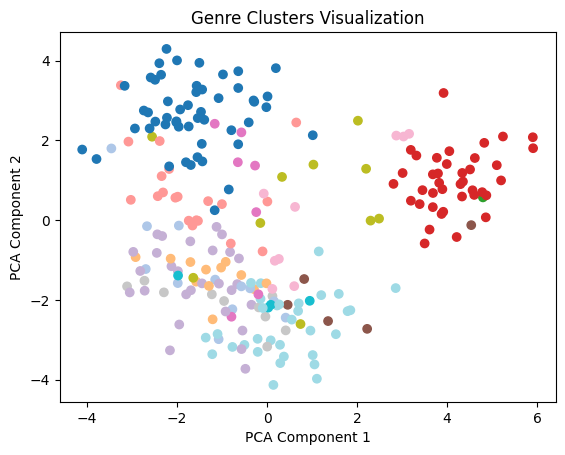

In [13]:
kmeans = KMeans(n_clusters=num_clusters, random_state=random_state)
kmeans.fit(embeddings)
labels = kmeans.labels_

# Print the genres grouped by cluster
clusters = {}
for genre, label in zip(genres, labels):
    if label not in clusters:
        clusters[label] = []
    clusters[label].append(genre)

clusters = dict(sorted(clusters.items()))

for cluster_id, genre_list in clusters.items():
    print(f"Cluster {cluster_id}: {', '.join(genre_list)}\n")

pca = PCA(n_components=2)
reduced_embeddings = pca.fit_transform(embeddings)
plt.scatter(reduced_embeddings[:, 0], reduced_embeddings[:, 1], c=labels, cmap='tab20')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('Genre Clusters Visualization')
plt.show()

In [14]:
def assign_cluster(x):
    clusters_row = []
    for k, v in clusters.items():
        if set(x) & set(v):
            clusters_row.append(k)
            
    return clusters_row


track_info["cluster_NLP"] = track_info["genres"].apply(assign_cluster)
df_exploded = track_info.explode("cluster_NLP")

for i in range(0, num_clusters):
    _df = df_exploded.loc[df_exploded["cluster_NLP"] == i, ["track_name", "artist", "track_url"]]
    elements = min(5, _df.shape[0])
    print(f"Cluster {i}")
    print(_df.sample(elements).values)

Cluster 0
[['Bloodbath (feat. Chino Moreno)' 'Polyphia'
  'https://open.spotify.com/track/2IMHE3XJcsqTIbSGOIY6Jy']
 ['Malignant Narcissism (De Slagwerker) - Snakes & Arrows Live Version'
  'Rush' 'https://open.spotify.com/track/0RgoYqO4DqiLakL7gEX8Pl']
 ['Lovesong - Remastered' 'The Cure'
  'https://open.spotify.com/track/2mIrfke7vosXAEWfz6ucyo']
 ['Talk Show Host' 'Radiohead'
  'https://open.spotify.com/track/3cMuGOGSaTWbwOurTS4b3Y']
 ['Formentera Lady' 'King Crimson'
  'https://open.spotify.com/track/5StX8dqW6uGKh1j9FN49yA']]
Cluster 1
[['Of Energy - Embers' 'TesseracT'
  'https://open.spotify.com/track/3w1eU4ZoEM4uiRJ0d3x2ik']
 ['The Lesson' 'Victor Wooten'
  'https://open.spotify.com/track/7K2kv5hSuJPi61vYJeGKEO']
 ['The Pressman' 'Primus'
  'https://open.spotify.com/track/2l3STudpnzAweQiCBPxjXh']
 ['23' 'Blonde Redhead'
  'https://open.spotify.com/track/4HIwL9ii9CcXpTOTzMq0MP']
 ['Eternal Consumption Engine' 'Primus'
  'https://open.spotify.com/track/0JuTJpqyY1qR5CVyB8LFBL']]
Clus

## By features

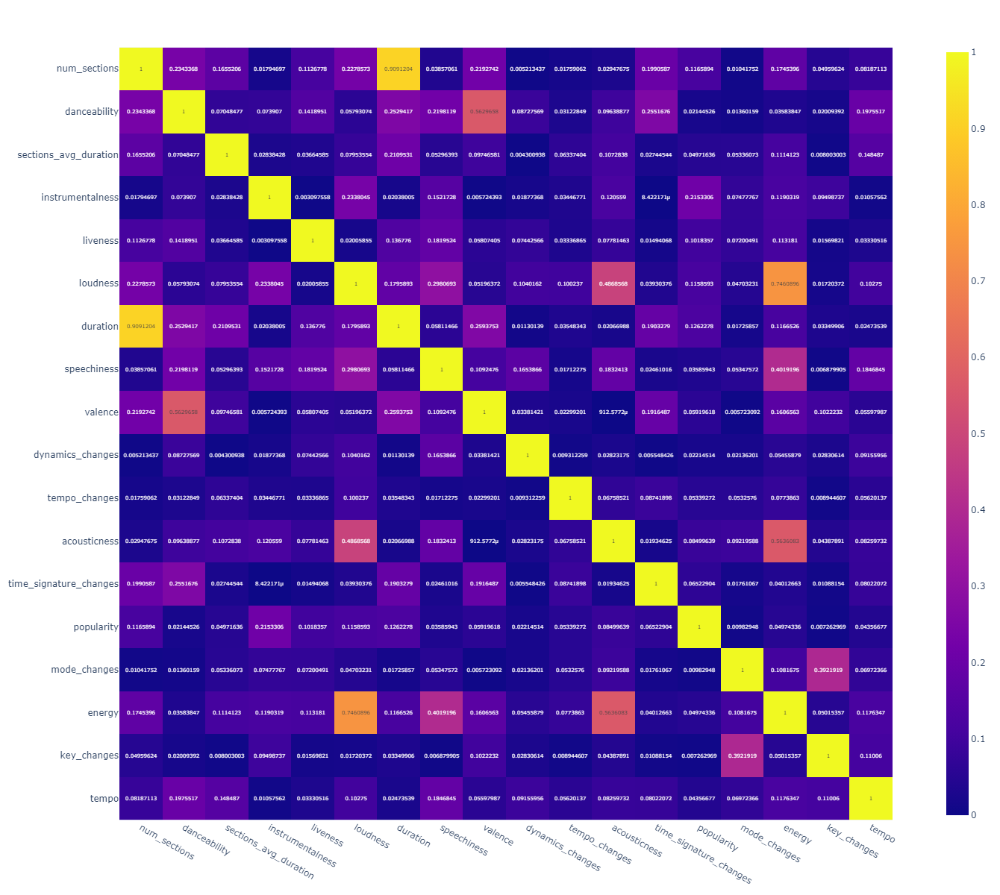

In [20]:
correlations = track_info[numerical_cols].corr().abs()

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

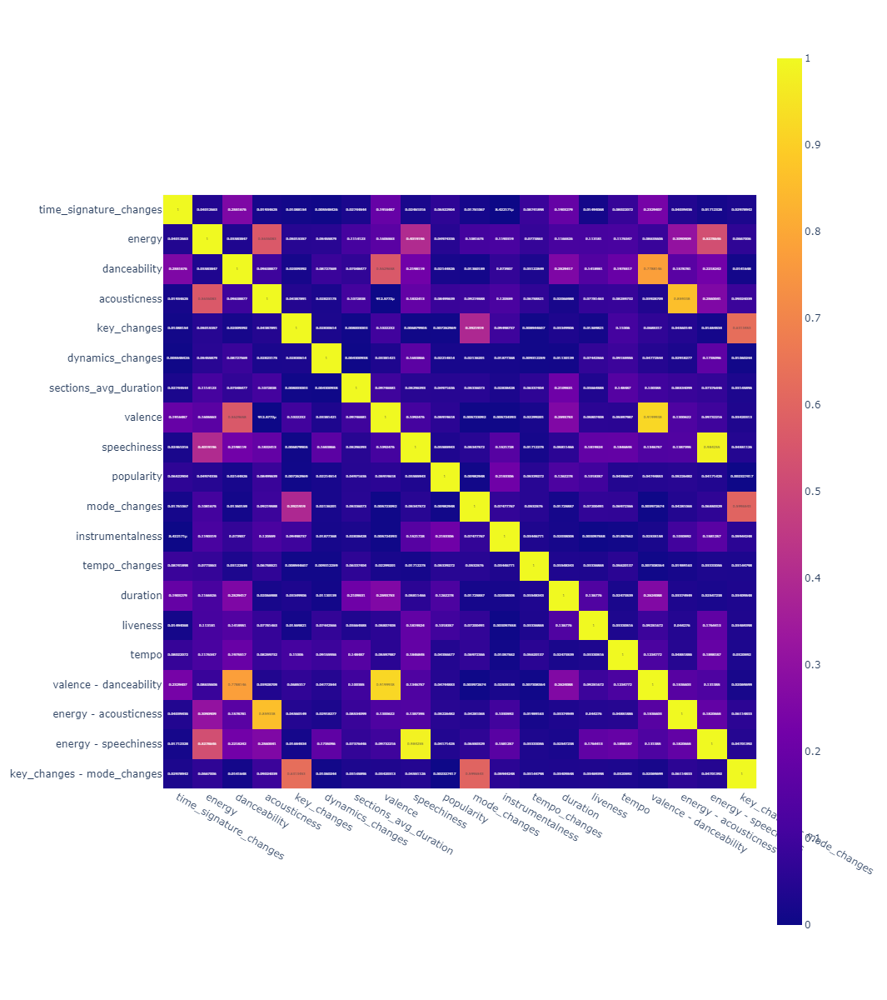

In [15]:
track_info_new_features = track_info.copy()

useless_cols = ["num_sections", "loudness"] 
numerical_cols_extra = list(set(numerical_cols).difference(useless_cols))

track_info_new_features = track_info_new_features[track_info_new_features.columns.difference(useless_cols)]

for pair in (("valence", "danceability"), ("energy", "acousticness"), ("energy", "speechiness"), ("key_changes", "mode_changes")):
    track_info_new_features[f"{pair[0]} - {pair[1]}"] = track_info_new_features[pair[0]] * track_info_new_features[pair[1]]
    numerical_cols_extra.append(f"{pair[0]} - {pair[1]}")

correlations = track_info_new_features[numerical_cols_extra].corr().abs()

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

<Axes: xlabel='key_changes', ylabel='mode_changes'>

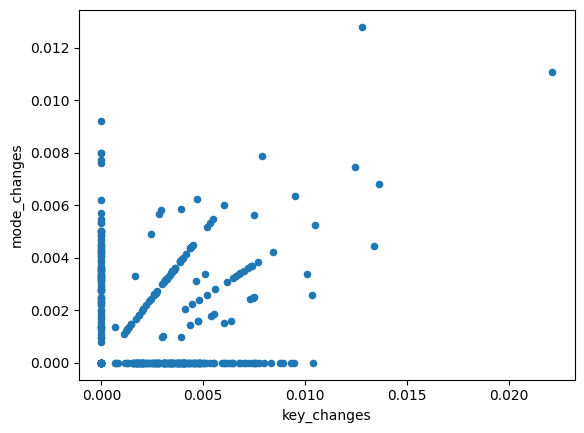

In [22]:
track_info.loc[:, ["mode_changes", "key_changes"]].plot(kind="scatter", y="mode_changes", x="key_changes")

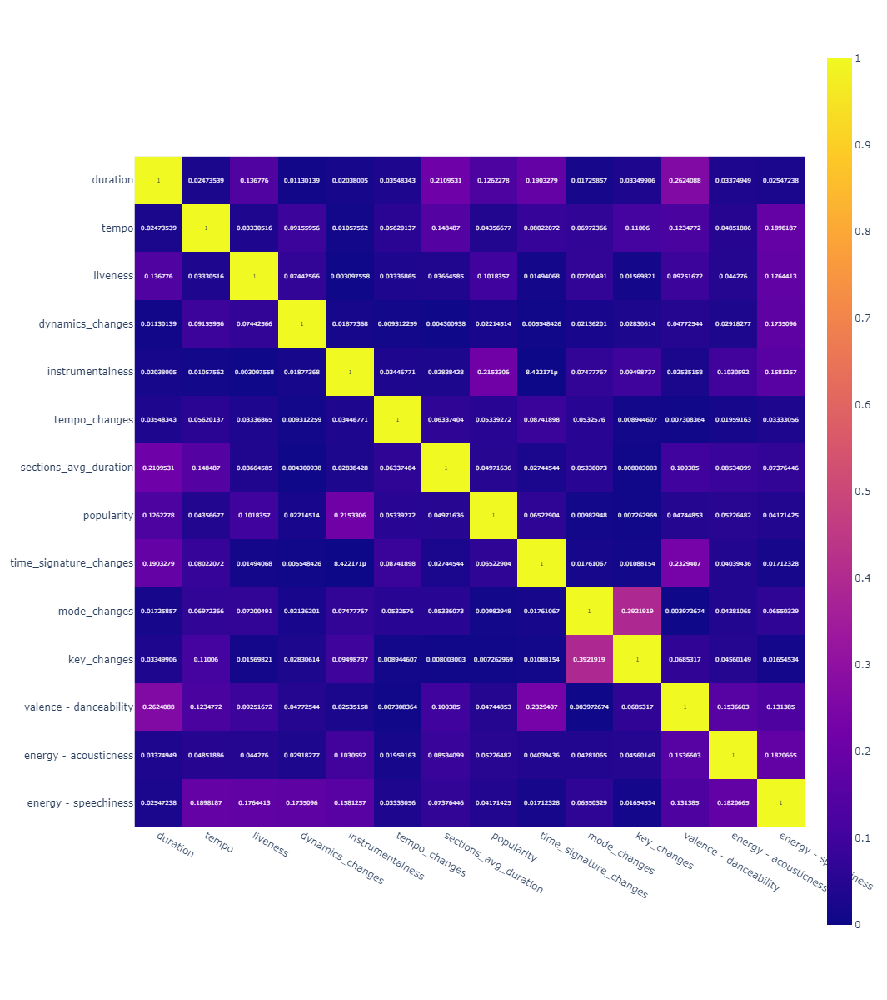

In [23]:
useless_cols = ["num_sections", "loudness", "energy", "acousticness", "valence", "danceability", "speechiness"] 
numerical_cols_extra = list(set(numerical_cols).difference(useless_cols))
numerical_cols_extra = numerical_cols_extra + ["valence - danceability", "energy - acousticness", "energy - speechiness"]

track_info_new_features = track_info_new_features[track_info_new_features.columns.difference(useless_cols)]

correlations = track_info_new_features[numerical_cols_extra].corr().abs()

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)

fig.show()

In [24]:
# track_info_alt = track_info.copy()

# useless_cols = ["num_sections", "loudness", "speechiness", "acousticness", "danceability"] #speechiness, acousticness, danceability
# _numerical_cols = list(set(numerical_cols).difference(useless_cols))

# track_info_alt = track_info_alt[track_info_alt.columns.difference(useless_cols)]
# track_info_alt["comb"]

# # for pair in (("valence", "danceability"), ("key_changes", "mode_changes")):
# #     track_info_alt[f"{pair[0]} - {pair[1]}"] = track_info_alt[pair[0]] * track_info_alt[pair[1]]
# #     _numerical_cols.append(f"{pair[0]} - {pair[1]}")

# correlations = track_info_alt[_numerical_cols].corr().abs()

# fig = px.imshow(correlations, text_auto=True)
# fig.update_layout(width=1300, height=1200, autosize=False)

# fig.show()

In [16]:
track_info_new_features = track_info.copy()
useless_cols = ["num_sections", "loudness", "energy", "acousticness", "valence", "danceability", "speechiness"] 
combinations_cols = [("valence", "danceability"), ("energy", "acousticness"), ("energy", "speechiness")]
numerical_cols_extra = list(set(numerical_cols).difference(useless_cols))

for pair in combinations_cols:
    track_info_new_features[f"{pair[0]} - {pair[1]}"] = track_info_new_features[pair[0]] * track_info_new_features[pair[1]]
    numerical_cols_extra.append(f"{pair[0]} - {pair[1]}")
    
numerical_cols_extra = numerical_cols_extra + categorical_cols + [f"{pair[0]} - {pair[1]}" for pair in combinations_cols]

X = track_info_new_features[numerical_cols_extra]
X = pd.get_dummies(X, columns=categorical_cols)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# try pca, delete features with corr


In [26]:
def gmm_bic_score(estimator, X):
    """Callable to pass to GridSearchCV that will use the BIC score."""
    # Make it negative since GridSearchCV expects a score to maximize
    return -estimator.bic(X)


param_grid = {
    "n_components": range(3, 20),
    "covariance_type": ["spherical", "tied", "diag", "full"],
}
grid_search = GridSearchCV(
    GaussianMixture(random_state=random_state), param_grid=param_grid, scoring=gmm_bic_score, 
)
grid_search.fit(X_scaled)

df = pd.DataFrame(grid_search.cv_results_)[
    ["param_n_components", "param_covariance_type", "mean_test_score"]
]
df["mean_test_score"] = -df["mean_test_score"]
df = df.rename(
    columns={
        "param_n_components": "Number of components",
        "param_covariance_type": "Type of covariance",
        "mean_test_score": "BIC score",
    }
)
df.sort_values(by="BIC score").head(10)

,Number of components,Type of covariance,BIC score
33,19,tied,-17458.345199
32,18,tied,-16970.532697
29,15,tied,-16970.364718
30,16,tied,-16785.940181
31,17,tied,-16623.959583
27,13,tied,-16380.617331
28,14,tied,-16277.565920
26,12,tied,-15054.584623
25,11,tied,-14164.668040
24,10,tied,-11782.950386


In [27]:
lower_limit = 0.1
gmm_components = 15

model = GaussianMixture(covariance_type="tied", n_components=gmm_components, random_state=random_state)
model.fit(X_scaled)
results = model.predict(X_scaled)
probabilities = model.predict_proba(X_scaled)

track_clustered = track_info.copy()
track_clustered["cluster_single"] = results
track_clustered["clusters"] = probabilities.tolist()
track_clustered["clusters"] = track_clustered["clusters"].apply(lambda x: [i for i, e in enumerate(x) if e > lower_limit])

track_clustered.head(5)

,num_sections,danceability,track_name,sections_avg_duration,instrumentalness,liveness,track_url,loudness,duration,speechiness,...,artist_id,key_changes,key,tempo,genres,explicit,case,cluster_NLP,cluster_single,clusters
0,7.0,0.677,No You Girls,31.970,0.000077,0.0967,https://open.spotify.com/track/4VP8QiCeaZq8BeT...,-4.102,223.79,0.0296,...,0XNa1vTidXlvJ2gHSsRi4A,0.000000,D,104.780,"[alternative rock, dance rock, indie rock, mod...",False,user,[0],5,[5]
1,14.0,0.449,Cliffs Of Dover - Instrumental,17.841,0.149000,0.2480,https://open.spotify.com/track/5qm0KiVKMXW1kq6...,-12.029,249.77,0.0405,...,4CxobvwTpmfpIEbkYh4pAb,0.008007,G,94.907,"[instrumental bluegrass, instrumental rock, pr...",False,user,"[0, 5, 7]",9,[9]
2,9.0,0.526,Genesis Ch.1. V.32,23.241,0.984000,0.1100,https://open.spotify.com/track/2Pmkm67wkf5ucIO...,-9.747,209.17,0.0372,...,2m62cc253Xvd9qYQ8d2X3d,0.000000,D,126.610,"[album rock, art rock, classic rock, mellow go...",False,user,"[0, 13]",5,[5]
3,13.0,0.745,Stop Don't Panic,20.936,0.588000,0.1880,https://open.spotify.com/track/38rSSEjYzSngmL0...,-5.549,272.17,0.0502,...,6J7biCazzYhU3gM9j1wfid,0.000000,C#,112.450,[dance pop],False,user,[10],14,[14]
4,27.0,0.270,America - 2003 Remaster,23.392,0.283000,0.3010,https://open.spotify.com/track/5jleoXgOf41HdLI...,-8.755,631.57,0.0630,...,7AC976RDJzL2asmZuz7qil,0.004750,D,176.030,"[album rock, art rock, classic rock, hard rock...",False,user,[0],5,[5]


In [28]:
genre_info_clustered = track_clustered.explode("genres")
genre_info_clustered["genres"] = genre_info_clustered["genres"].fillna("No Genre")

cluster_items = genre_info_clustered[["cluster_single", "genres"]].groupby("cluster_single").agg(list).reset_index()
cluster_items["genres"] = cluster_items["genres"].apply(lambda x: list(set(x)))

for _, row in cluster_items.iterrows():
    print(f"Cluster {row['cluster_single']}: {', '.join(row['genres'])}\n")

Cluster 0: melancholia, rap rock, grunge, jam band, jazz, progressive death metal, motown, No Genre, british invasion, uk doom metal, birmingham metal, swedish progressive metal, microtonal, psychedelic rock, progressive jazz fusion, modern rock, melodic thrash, soft rock, stoner rock, conscious hip hop, progressive groove metal, rap metal, contemporary jazz, speed metal, video game music, post-hardcore, double drumming, swedish metal, art rock, electric bass, permanent wave, french metal, supergroup, dance-punk, political hip hop, french death metal, electronic djent, hard rock, progressive rock, cascadia psych, merseybeat, singer-songwriter, old school thrash, gothic metal, bebop, opera metal, progressive metal, acoustic rock, alternative rock, jazz fusion, trip hop, album rock, uk post-punk, laboratorio, dark pop, modern progressive rock, thrash metal, australian psych, emo, groove metal, avant-garde metal, british math rock, math rock, neo-psychedelic, symphonic rock, metal, classi

In [29]:
for i in range(0, gmm_components):
    _df = track_clustered.loc[track_clustered["cluster_single"] == i, ["track_name", "artist", "track_url"]]
    elements = min(5, _df.shape[0])
    print(f"Cluster {i}")
    print(_df.sample(elements).values)

Cluster 0
[['Pneuma' 'TOOL' 'https://open.spotify.com/track/03sEzk1VyrUZSgyhoQR0LZ']
 ['The Wild Healer' 'Gojira'
  'https://open.spotify.com/track/1Pa0DVjBUGreCBHIh81G50']
 ['Without a Face' 'Rage Against The Machine'
  'https://open.spotify.com/track/3DdOsUq1M9mJBFVR0xbSOx']
 ['Tears' 'Rush' 'https://open.spotify.com/track/5L2dN3m2sliHCEojBDt7wR']
 ['Iron Lung' 'King Gizzard & The Lizard Wizard'
  'https://open.spotify.com/track/7G69PANdawtb2rsG2ZGEQa']]
Cluster 1
[['Zed and Two Naughts' 'The Mars Volta'
  'https://open.spotify.com/track/38CItr5N2JM2XFLLyWUVw0']
 ['Dyslexicon' 'The Mars Volta'
  'https://open.spotify.com/track/07DiJLA3Qef8OT23D4qlWC']]
Cluster 2
[['Be Happy' 'Mahavishnu Orchestra'
  'https://open.spotify.com/track/3wWWyyeTPHrC9mDKQ9Zu2w']
 ['Tippa My Tongue' 'Red Hot Chili Peppers'
  'https://open.spotify.com/track/3s53zBEi1ZU6dJj19eFOxW']
 ['Rosemary' 'Deftones'
  'https://open.spotify.com/track/4FEr6dIdH6EqLKR0jB560J']
 ['125th Street Congress' 'Weather Report'
  '

In [30]:
genre_info_clustered = track_clustered.explode("genres")
genre_info_clustered["genres"] = genre_info_clustered["genres"].fillna("No Genre")
genre_info_clustered = genre_info_clustered.explode("clusters")

cluster_items = genre_info_clustered[["clusters", "genres"]].groupby("clusters").agg(list).reset_index()
cluster_items["genres"] = cluster_items["genres"].apply(lambda x: list(set(x)))

for _, row in cluster_items.iterrows():
    print(f"Cluster {row['clusters']}: {', '.join(row['genres'])}\n")

Cluster 0: melancholia, rap rock, grunge, jam band, jazz, progressive death metal, motown, No Genre, british invasion, uk doom metal, birmingham metal, swedish progressive metal, microtonal, psychedelic rock, progressive jazz fusion, modern rock, melodic thrash, soft rock, stoner rock, conscious hip hop, progressive groove metal, rap metal, contemporary jazz, speed metal, video game music, post-hardcore, double drumming, swedish metal, art rock, electric bass, permanent wave, french metal, supergroup, dance-punk, political hip hop, french death metal, electronic djent, hard rock, progressive rock, cascadia psych, merseybeat, singer-songwriter, old school thrash, gothic metal, bebop, opera metal, progressive metal, acoustic rock, alternative rock, jazz fusion, trip hop, album rock, uk post-punk, laboratorio, dark pop, modern progressive rock, thrash metal, australian psych, emo, groove metal, avant-garde metal, british math rock, math rock, neo-psychedelic, symphonic rock, metal, classi

In [31]:
df_exploded = track_clustered.explode("clusters")

for i in range(0, gmm_components):
    _df = df_exploded.loc[df_exploded["clusters"] == i, ["track_name", "artist", "track_url"]]
    elements = min(5, _df.shape[0])
    print(f"Cluster {i}")
    print(_df.sample(elements).values)

Cluster 0
[['Born As Ghosts' 'Rage Against The Machine'
  'https://open.spotify.com/track/3moeHk8eIajvUEzVocXukf']
 ['Saucy' 'Polyphia'
  'https://open.spotify.com/track/6VcimclPSNITdEnc6gZGNQ']
 ['Stadium Arcadium' 'Red Hot Chili Peppers'
  'https://open.spotify.com/track/4y84ILALZSa4LyP6H7NVjR']
 ['War Pigs' 'Black Sabbath'
  'https://open.spotify.com/track/0W35nxtHtFlseSojmygEsf']
 ['The Pretender' 'Foo Fighters'
  'https://open.spotify.com/track/7x8dCjCr0x6x2lXKujYD34']]
Cluster 1
[['Dyslexicon' 'The Mars Volta'
  'https://open.spotify.com/track/07DiJLA3Qef8OT23D4qlWC']
 ['Zed and Two Naughts' 'The Mars Volta'
  'https://open.spotify.com/track/38CItr5N2JM2XFLLyWUVw0']]
Cluster 2
[['Freefall' 'Camel'
  'https://open.spotify.com/track/0VLETiR8ft4wZHlCQf3UAf']
 ['Naked in the Rain' 'Red Hot Chili Peppers'
  'https://open.spotify.com/track/6xid2NOIS1aqviPPe67OqF']
 ['The Heaviest Matter of the Universe' 'Gojira'
  'https://open.spotify.com/track/2pZsQqXFgcY03vRyZxSQhU']
 ['Teflon' 'The

# a

# Regression

## EDA

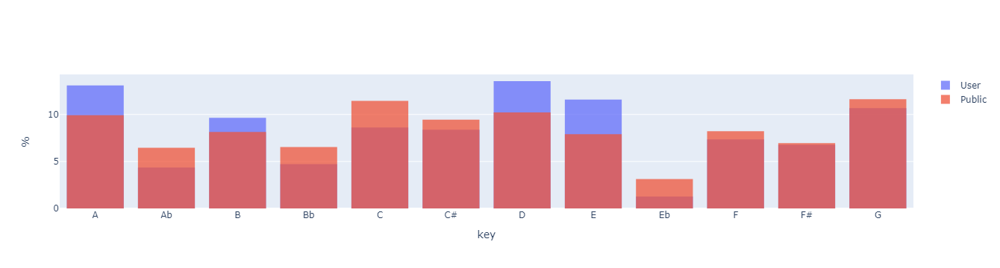

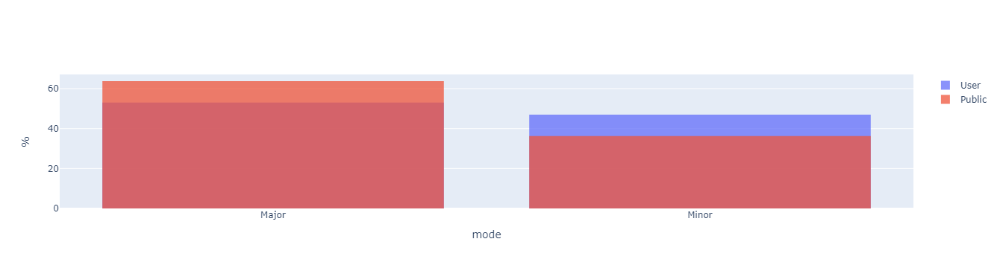

In [33]:
for col in categorical_cols:
    df = pd.concat([track_info, public_data]).loc[:, ["case", col]]
    df = df.sort_values(by=col)
    
    fig = go.Figure()
    fig.add_trace(go.Histogram(x=df.loc[df["case"] == "user", col], histnorm="percent", name="User"))
    fig.add_trace(go.Histogram(x=df.loc[df["case"] == "public", col], histnorm="percent", name="Public"))

    fig.update_layout(
        barmode="overlay",
        xaxis_title_text=col,
        yaxis_title_text='%'
    )
    fig.update_traces(opacity=0.75)
    fig.show()

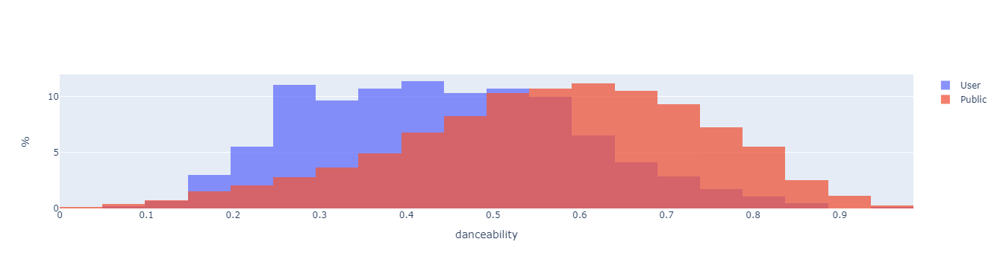

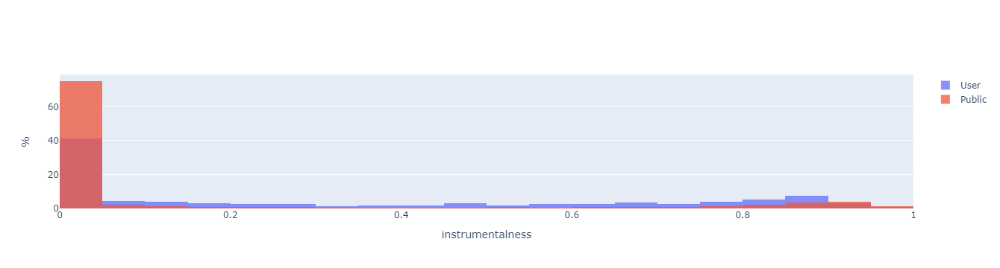

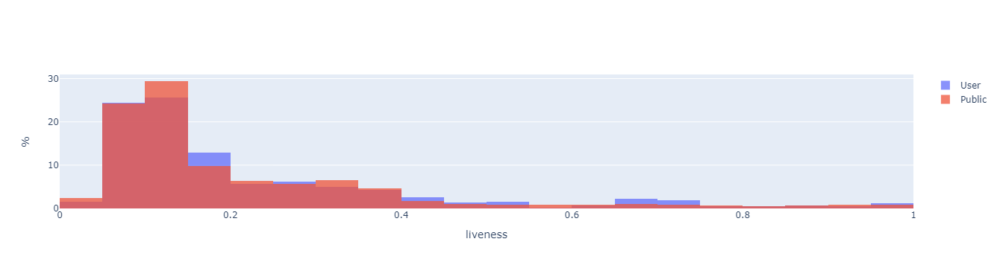

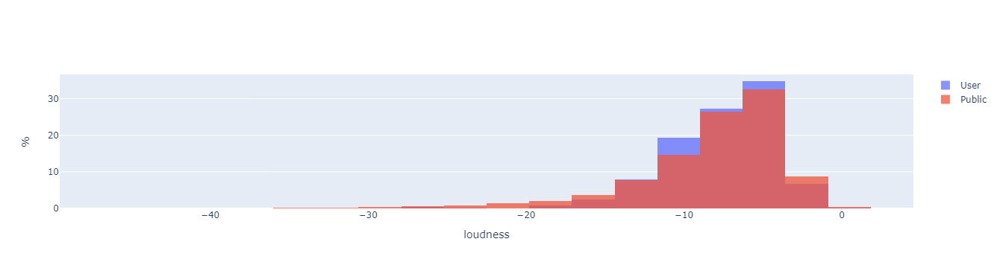

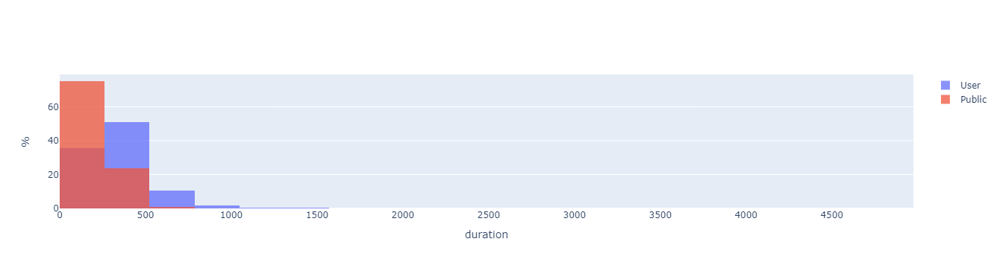

...

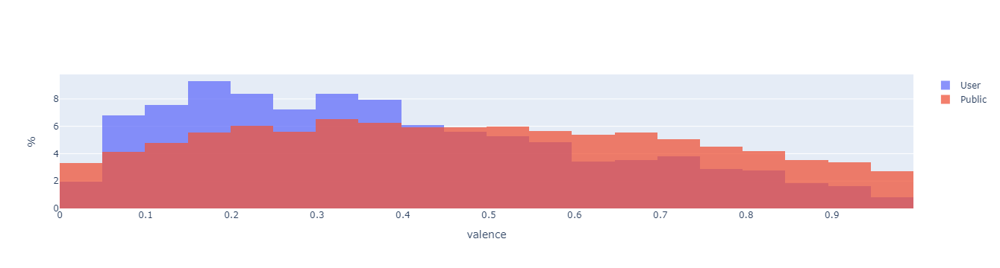

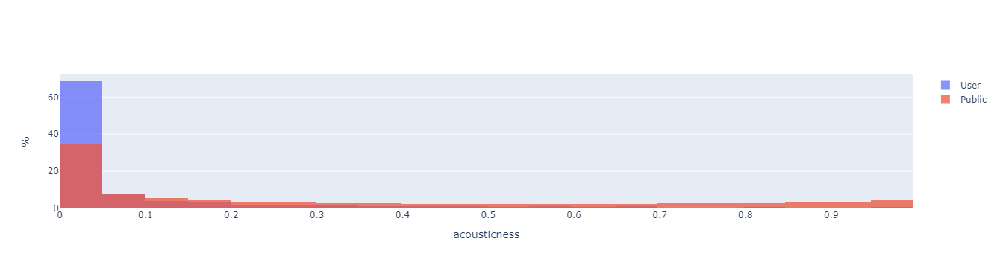

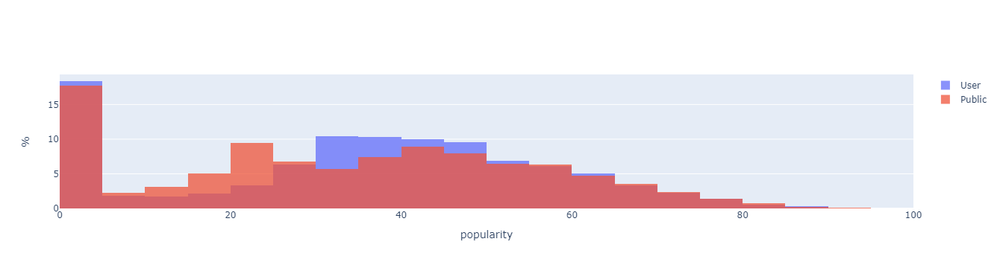

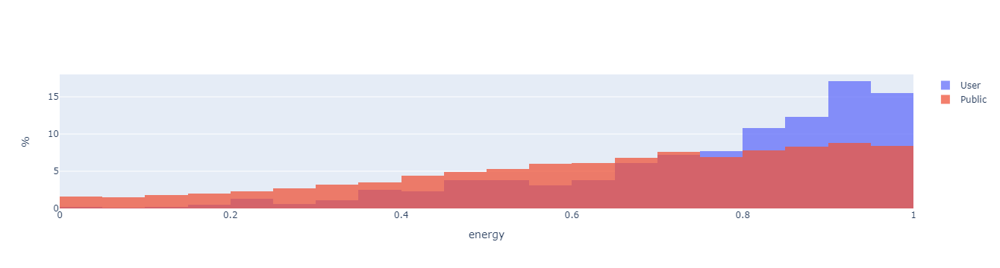

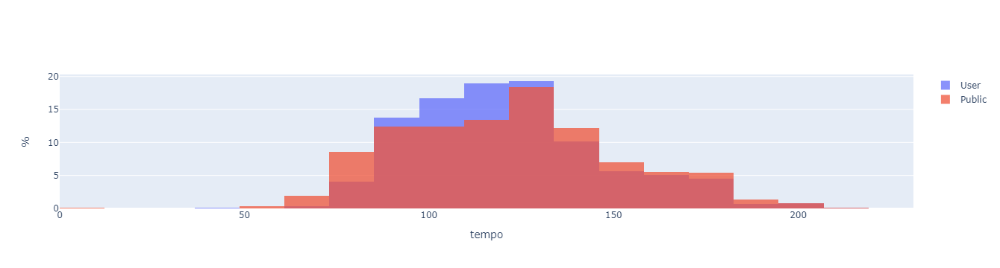

In [34]:
for col in numerical_cols:
    if col in track_info.columns and col in public_data.columns:
        df = pd.concat([track_info, public_data]).loc[:, ["case", col]]
        fig = go.Figure()

        bin_start = df[col].min()
        bin_end = df[col].max()
        bin_size = abs(bin_end - bin_start) / 20

        fig.add_trace(go.Histogram(x=df.loc[df["case"] == "user", col], histnorm="percent", name="User", autobinx=False, xbins=dict( 
                start=bin_start,
                end=bin_end,
                size=bin_size
            )))
        fig.add_trace(go.Histogram(x=df.loc[df["case"] == "public", col], histnorm="percent", name="Public", autobinx=False, xbins=dict(
                start=bin_start,
                end=bin_end,
                size=bin_size
            )))

        fig.update_layout(
            barmode="overlay",
            xaxis_title_text=col,
            yaxis_title_text='%'
        )
        fig.update_traces(opacity=0.75)
        fig.show()

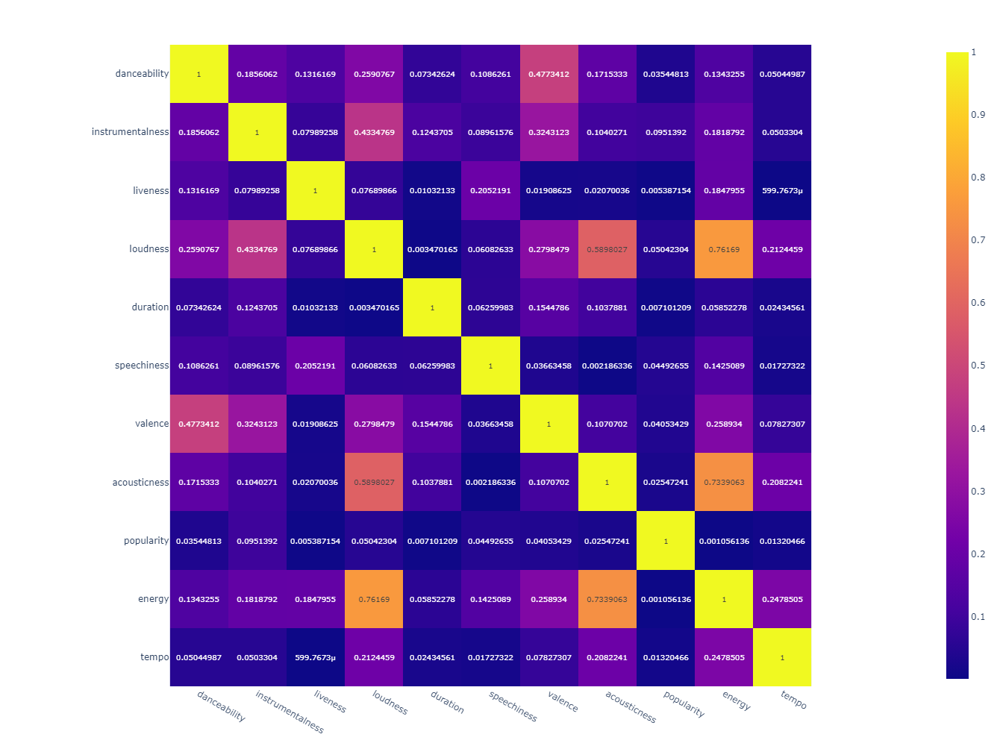

In [35]:
correlations_public = public_data[numerical_cols_public].corr().abs()

fig = px.imshow(correlations_public, text_auto=True)
fig.update_layout(width=1100, height=1000, autosize=False)

fig.show()

In [17]:
# Encoding categorical features
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from scipy.stats import f_oneway, chi2_contingency

df = public_data.copy()

one_hot_encoder = OneHotEncoder()
encoded_features = one_hot_encoder.fit_transform(df[categorical_cols])

encoded_df = pd.DataFrame(encoded_features.todense(), columns=one_hot_encoder.get_feature_names_out(categorical_cols))
df_encoded = pd.concat([df.drop(categorical_cols, axis=1), encoded_df], axis=1)

label_encoder = LabelEncoder()
df_encoded["track_genre"] = label_encoder.fit_transform(df_encoded['track_genre'])
numerical_features = numerical_cols_public
output = df_encoded['track_genre']

for feature in numerical_features:
    groups = [df_encoded[feature][df_encoded['track_genre'] == category] for category in df_encoded['track_genre'].unique()]
    f_val, p_val = f_oneway(*groups)
    print(f"ANOVA for {feature}: F-value = {f_val:.3f}, p-value = {p_val:.3f}")

categorical_features = encoded_df.columns

for feature in categorical_features:
    contingency_table = pd.crosstab(df_encoded[feature], output)
    chi2, p_value, _, _ = chi2_contingency(contingency_table)
    print(f"Chi-square test between {feature} and output: chi2 = {chi2:.3f}, p-value = {p_value:.3f}")

ANOVA for danceability: F-value = 714.110, p-value = 0.000
ANOVA for instrumentalness: F-value = 832.807, p-value = 0.000
ANOVA for liveness: F-value = 180.186, p-value = 0.000
ANOVA for loudness: F-value = 828.209, p-value = 0.000
ANOVA for duration: F-value = 198.542, p-value = 0.000
ANOVA for speechiness: F-value = 797.292, p-value = 0.000
ANOVA for valence: F-value = 441.163, p-value = 0.000
ANOVA for acousticness: F-value = 960.142, p-value = 0.000
ANOVA for popularity: F-value = 343.462, p-value = 0.000
ANOVA for energy: F-value = 842.844, p-value = 0.000
ANOVA for tempo: F-value = 93.752, p-value = 0.000
Chi-square test between key_A and output: chi2 = 750.010, p-value = 0.000
Chi-square test between key_Ab and output: chi2 = 782.307, p-value = 0.000
Chi-square test between key_B and output: chi2 = 732.271, p-value = 0.000
Chi-square test between key_Bb and output: chi2 = 670.181, p-value = 0.000
Chi-square test between key_C and output: chi2 = 919.286, p-value = 0.000
Chi-squar

In [10]:
track_info_regression = public_data.copy()
useless_cols = ["loudness", "energy", "acousticness", "valence", "danceability"] 
combinations_cols = [("valence", "danceability"), ("energy", "acousticness"), ("energy", "loudness")]
numerical_cols_extra = list(set(numerical_cols_public).difference(useless_cols))

for pair in combinations_cols:
    track_info_regression[f"{pair[0]} - {pair[1]}"] = track_info_regression[pair[0]] * track_info_regression[pair[1]]
    numerical_cols_extra.append(f"{pair[0]} - {pair[1]}")
    
# numerical_cols_extra = numerical_cols_extra + [f"{pair[0]} - {pair[1]}" for pair in combinations_cols]
regression_cols = numerical_cols_extra + categorical_cols

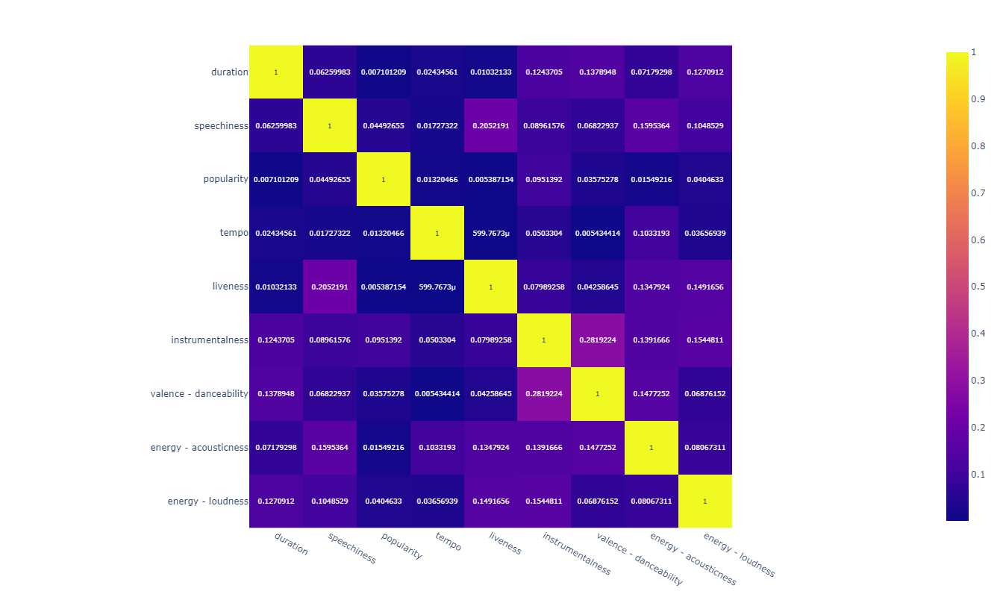

In [38]:
correlations_public = track_info_regression[numerical_cols_extra].corr().abs()

fig = px.imshow(correlations_public, text_auto=True)
fig.update_layout(width=1100, height=800, autosize=False)

fig.show()

In [19]:
X = track_info_regression[regression_cols]
X = pd.get_dummies(X, columns=categorical_cols)
Y = track_info_regression["track_genre"]

label_encoder = OneHotEncoder()
Y_encoded = label_encoder.fit_transform(pd.DataFrame(Y)).todense()

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

## Pycaret

In [17]:
import pycaret.classification as pc

data = track_info_regression.groupby("track_genre").sample(n=500, random_state=random_state)
data = data[regression_cols + ["track_genre"]]
# X_train, X_test, y_train, y_test = train_test_split(X_scaled, Y_encoded, test_size=0.1, random_state=random_state)
data['track_genre'] = data['track_genre'].astype('category')
data['key'] = data['key'].astype('category')
data['mode'] = data['mode'].astype('category')
data["popularity"] = data["popularity"].astype(np.int16)

for col in ("duration", "speechiness", "tempo", "liveness", "instrumentalness", "valence - danceability", "energy - acousticness", "energy - loudness"):
    data[col] = data[col].astype(np.float32)

try:
    best_model = pc.load_model('model_pycaret')    

except FileNotFoundError:
    clf1 = pc.setup(data, target='track_genre', verbose=False)
    best_model = pc.compare_models()
    pc.save_model(best_model, 'model_pycaret')

# # Print best model
print(best_model)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
rf,Random Forest Classifier,0.2919,0.8708,0.2919,0.2776,0.2783,0.2856,0.2857,25.8050
xgboost,Extreme Gradient Boosting,0.2876,0.9209,0.2876,0.2881,0.2853,0.2813,0.2813,13.9960
gbc,Gradient Boosting Classifier,0.2631,0.0000,0.2631,0.2566,0.2552,0.2566,0.2567,185.5970
dt,Decision Tree Classifier,0.1877,0.6032,0.1877,0.1919,0.1882,0.1805,0.1806,0.3570
lda,Linear Discriminant Analysis,0.1387,0.0000,0.1387,0.1123,0.1114,0.1310,0.1314,0.1160
nb,Naive Bayes,0.1298,0.8104,0.1298,0.1261,0.1063,0.1221,0.1230,0.2010
qda,Quadratic Discriminant Analysis,0.1252,0.0000,0.1252,0.1253,0.1097,0.1174,0.1180,0.1840
lr,Logistic Regression,0.1246,0.0000,0.1246,0.0982,0.0938,0.1169,0.1174,23.0360
knn,K Neighbors Classifier,0.1093,0.6292,0.1093,0.1279,0.1070,0.1014,0.1017,0.7480
ridge,Ridge Classifier,0.1039,0.0000,0.1039,0.0678,0.0585,0.0959,0.0976,0.0980


Transformation Pipeline and Model Successfully Saved
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       monotonic_cst=None, n_estimators=100, n_jobs=-1,
                       oob_score=False, random_state=3603, verbose=0,
                       warm_start=False)


In [9]:
# from pycaret.classification import setup, compare_models, load_model, save_model, evaluate_model
best_model = pc.load_model('model_pycaret')    

In [27]:
# pc.tune_model(best_model)
# data = track_info_regression.groupby("track_genre").sample(n=500, random_state=random_state)
data = track_info_regression[regression_cols + ["track_genre"]]
# X_train, X_test, y_train, y_test = train_test_split(X_scaled, Y_encoded, test_size=0.1, random_state=random_state)
data['track_genre'] = data['track_genre'].astype('category')
data['key'] = data['key'].astype('category')
data['mode'] = data['mode'].astype('category')
data["popularity"] = data["popularity"].astype(np.int16)

for col in ("duration", "speechiness", "tempo", "liveness", "instrumentalness", "valence - danceability", "energy - acousticness", "energy - loudness"):
    data[col] = data[col].astype(np.float32)

In [29]:
clf1 = pc.setup(data, target='track_genre', verbose=False)
pc.save_experiment('regression')

# clf1 = pc.load_experiment('regression', data=data)

In [30]:
xgboost_model = pc.create_model('xgboost')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.2890,0.9345,0.2890,0.2864,0.2858,0.2827,0.2827
1,0.2852,0.9347,0.2852,0.2839,0.2827,0.2789,0.2789
2,0.2919,0.9353,0.2919,0.2875,0.2875,0.2856,0.2856
3,0.2957,0.9365,0.2957,0.2964,0.2937,0.2895,0.2896
4,0.2925,0.9345,0.2925,0.2922,0.2904,0.2862,0.2863
5,0.2876,0.9334,0.2876,0.2870,0.2854,0.2813,0.2813
6,0.2927,0.9352,0.2927,0.2941,0.2912,0.2865,0.2865
7,0.2906,0.9355,0.2906,0.2910,0.2889,0.2843,0.2844
8,0.2919,0.9348,0.2919,0.2957,0.2915,0.2856,0.2856


In [31]:
pc.save_model(xgboost_model, 'xgboost_model')
# xgboost_model = pc.load_model('xgboost_model')    

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['duration', 'liveness',
                                              'instrumentalness', 'tempo',
                                              'popularity', 'speechiness',
                                              'valence - danceability',
                                              'energy - acousticness',
                                              'energy - loudness'],...
                                importance_type=None,
                                interaction_constraints=None, learning_rate=None,
                                max_bin=None, max_cat_threshold=None,
                                max_cat_

In [32]:
tuned_model = pc.tune_model(xgboost_model)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.3069,0.9390,0.3069,0.3019,0.3017,0.3008,0.3008
1,0.3036,0.9390,0.3036,0.3004,0.2998,0.2975,0.2975
2,0.3024,0.9396,0.3024,0.3001,0.2986,0.2962,0.2963
3,0.3035,0.9406,0.3035,0.3003,0.2993,0.2973,0.2974
4,0.2996,0.9386,0.2996,0.2994,0.2969,0.2934,0.2935
5,0.3041,0.9386,0.3041,0.3005,0.2998,0.2980,0.2980
6,0.3013,0.9401,0.3013,0.2984,0.2973,0.2951,0.2951
7,0.3014,0.9395,0.3014,0.2976,0.2971,0.2952,0.2952
8,0.3035,0.9403,0.3035,0.3018,0.3000,0.2973,0.2974


Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [33]:
pc.save_model(tuned_model, 'tuned_model')
# tuned_model = pc.load_model('tuned_model')    

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=Memory(location=None),
          steps=[('label_encoding',
                  TransformerWrapperWithInverse(exclude=None, include=None,
                                                transformer=LabelEncoder())),
                 ('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['duration', 'liveness',
                                              'instrumentalness', 'tempo',
                                              'popularity', 'speechiness',
                                              'valence - danceability',
                                              'energy - acousticness',
                                              'energy - loudness'],...
                                importance_type=None,
                                interaction_constraints=None, learning_rate=0.1,
                                max_bin=None, max_cat_threshold=None,
                                max_cat_t

In [28]:
# from pycaret.classification import plot_model

help(pc.plot_model)

Help on function plot_model in module pycaret.classification.functional:

plot_model(estimator, plot: str = 'auc', scale: float = 1, save: bool = False, fold: Union[int, Any, NoneType] = None, fit_kwargs: Optional[dict] = None, plot_kwargs: Optional[dict] = None, groups: Union[str, Any, NoneType] = None, verbose: bool = True, display_format: Optional[str] = None) -> Optional[str]
    This function analyzes the performance of a trained model on holdout set.
    It may require re-training the model in certain cases.
    
    Example
    -------
    >>> from pycaret.datasets import get_data
    >>> juice = get_data('juice')
    >>> from pycaret.classification import *
    >>> exp_name = setup(data = juice,  target = 'Purchase')
    >>> lr = create_model('lr')
    >>> plot_model(lr, plot = 'auc')
    
    
    estimator: scikit-learn compatible object
        Trained model object
    
    
    plot: str, default = 'auc'
        List of available plots (ID - Name):
    
        * 'pipeline'

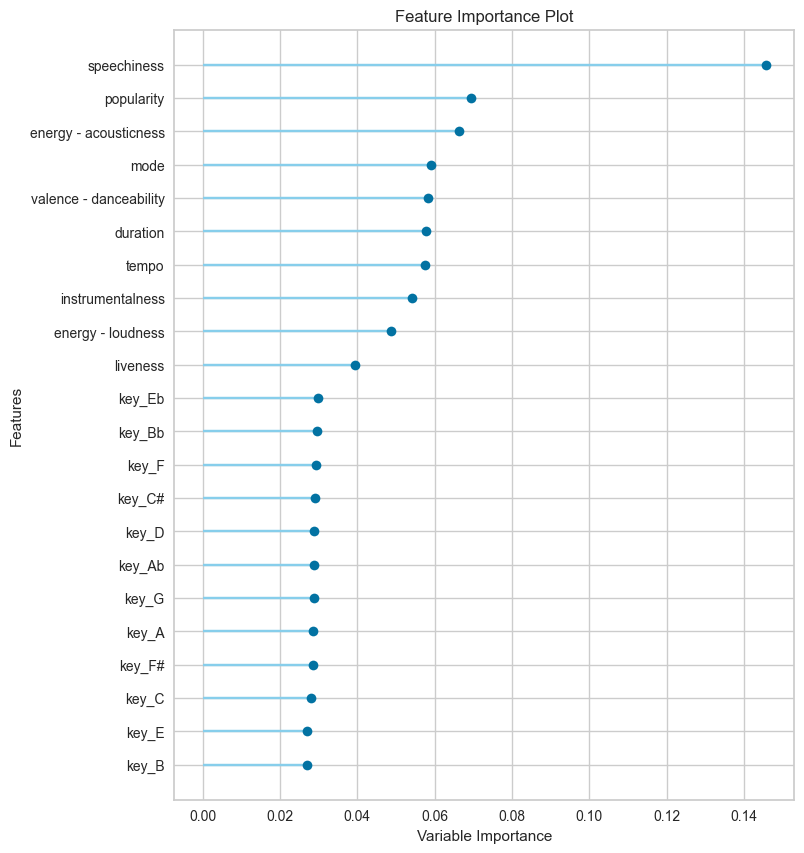

In [15]:
pc.plot_model(tuned_model, plot = 'feature_all')

In [36]:
preds = pc.predict_model(tuned_model)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Extreme Gradient Boosting,0.3000,0.9408,0.3000,0.2960,0.2961,0.2938,0.2938


,duration,liveness,instrumentalness,tempo,popularity,speechiness,valence - danceability,energy - acousticness,energy - loudness,key,mode,track_genre,prediction_label,prediction_score
70416,214.988007,0.0916,0.000000,81.460999,27,0.0738,0.325465,0.008392,-4.157727,D,Major,mandopop,dancehall,0.2950
81967,359.252991,0.0274,0.000002,107.985001,65,0.1090,0.752346,0.047829,-6.433820,A,Minor,pop,disco,0.3247
88193,224.800003,0.0656,0.003290,124.994003,3,0.0864,0.742210,0.066201,-3.359228,G,Major,reggae,latin,0.2599
52805,143.399994,0.1240,0.000592,117.484001,10,0.0299,0.516988,0.191868,-3.128652,D,Major,honky-tonk,honky-tonk,0.8271
12717,346.247009,0.1110,0.000000,76.485001,51,0.0465,0.097740,0.164065,-4.749250,Ab,Major,cantopop,world-music,0.1740
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
76261,153.240997,0.1430,0.000017,94.464996,25,0.0301,0.047561,0.239875,-2.843655,Bb,Major,opera,show-tunes,0.5353
100817,207.960007,0.3640,0.000416,68.205002,35,0.0458,0.170259,0.068445,-5.224635,Ab,Minor,ska,hard-rock,0.3000
39934,210.425995,0.5090,0.000000,108.037003,37,0.0556,0.656040,0.051613,-4.103541,F,Major,german,punk-rock,0.2422
39837,188.570999,0.1240,0.004740,126.003998,0,0.0383,0.114061,0.000136,-3.682434,Bb,Minor,german,groove,0.2254


In [57]:
preds["success"] = preds["track_genre"].eq(preds["prediction_label"]) 
success = preds.loc[:, ["track_genre", "success"]].groupby(["track_genre"]).agg(
    total=("track_genre", "count"),
    success=("success", "sum")).reset_index()
success["error"] = 100 * success["success"] / success["total"]

success.sort_values(by="error")

,track_genre,total,success,error
99,singer-songwriter,300,5,1.666667
32,electronic,300,10,3.333333
88,reggae,300,12,4.000000
30,edm,300,16,5.333333
2,alt-rock,300,19,6.333333
...,...,...,...,...
93,romance,300,221,73.666667
52,honky-tonk,300,226,75.333333
18,comedy,300,233,77.666667
42,grindcore,300,247,82.333333


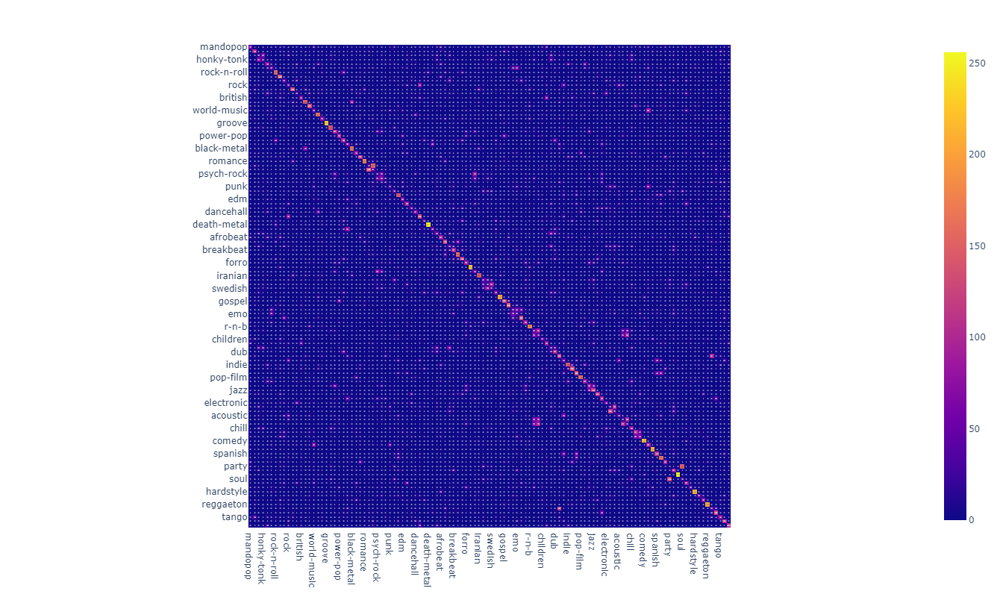

In [46]:
from sklearn.metrics import confusion_matrix

confusion = confusion_matrix(preds["track_genre"], preds["prediction_label"])

fig = px.imshow(confusion, text_auto=True, x=preds["track_genre"].unique(), y=preds["track_genre"].unique())
fig.update_layout(width=1300, height=800, autosize=False)

fig.show()

In [60]:
# gbc_model = pc.create_model('gbc')
rf_model = pc.create_model('rf')

# gbc_model = pc.tune_model(gbc_model)
rf_model = pc.tune_model(rf_model)

mixed_model = pc.blend_models([tuned_model, rf_model])

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,18:16:31
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Random Forest Classifier


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

ValueError: 
All the 10 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 908, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 4194304 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 4194304 bytes

--------------------------------------------------------------------------------
1 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 933888 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 933888 bytes

--------------------------------------------------------------------------------
1 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 14942208 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 14942208 bytes

--------------------------------------------------------------------------------
1 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 1867776 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 1867776 bytes

--------------------------------------------------------------------------------
1 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 179, in _parallel_build_trees
    indices = _generate_sample_indices(
              ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 133, in _generate_sample_indices
    sample_indices = random_instance.randint(
                     ^^^^^^^^^^^^^^^^^^^^^^^^
  File "mtrand.pyx", line 779, in numpy.random.mtrand.RandomState.randint
  File "_bounded_integers.pyx", line 1434, in numpy.random._bounded_integers._rand_int32
numpy.core._exceptions._ArrayMemoryError: Unable to allocate 281. KiB for an array with shape (71820,) and data type int32
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
numpy.core._exceptions._ArrayMemoryError: Unable to allocate 281. KiB for an array with shape (71820,) and data type int32

--------------------------------------------------------------------------------
3 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 909, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 59768832 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 59768832 bytes

--------------------------------------------------------------------------------
1 fits failed with the following error:
joblib.externals.loky.process_executor._RemoteTraceback: 
"""
Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\_parallel_backends.py", line 273, in _wrap_func_call
    return func()
           ^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in __call__
    return [func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 589, in <listcomp>
    return [func(*args, **kwargs)
            ^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 129, in __call__
    return self.function(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 192, in _parallel_build_trees
    tree._fit(
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\tree\_classes.py", line 472, in _fit
    builder.build(self.tree_, X, y, sample_weight, missing_values_in_feature_mask)
  File "sklearn\\tree\\_tree.pyx", line 166, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 285, in sklearn.tree._tree.DepthFirstTreeBuilder.build
  File "sklearn\\tree\\_tree.pyx", line 940, in sklearn.tree._tree.Tree._add_node
  File "sklearn\\tree\\_tree.pyx", line 908, in sklearn.tree._tree.Tree._resize_c
  File "sklearn\\tree\\_utils.pyx", line 35, in sklearn.tree._utils.safe_realloc
MemoryError: could not allocate 2097152 bytes
"""

The above exception was the direct cause of the following exception:

Traceback (most recent call last):
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 278, in fit
    fitted_estimator = self._memory_fit(
                       ^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\memory.py", line 353, in __call__
    return self.func(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\pycaret\internal\pipeline.py", line 69, in _fit_one
    transformer.fit(*args)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\ensemble\_forest.py", line 489, in fit
    trees = Parallel(
            ^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\utils\parallel.py", line 67, in __call__
    return super().__call__(iterable_with_config)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1952, in __call__
    return output if self.return_generator else list(output)
                                                ^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1595, in _get_outputs
    yield from self._retrieve()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1699, in _retrieve
    self._raise_error_fast()
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 1734, in _raise_error_fast
    error_job.get_result(self.timeout)
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 736, in get_result
    return self._return_or_raise()
           ^^^^^^^^^^^^^^^^^^^^^^^
  File "C:\Users\jcf\AppData\Local\Programs\Python\Python311\Lib\site-packages\joblib\parallel.py", line 754, in _return_or_raise
    raise self._result
MemoryError: could not allocate 2097152 bytes


In [ ]:
pc.save_model(mixed_model, 'mixed_model')
# mixed_model = pc.load_model('mixed_model
')   

In [ ]:
final_best = finalize_model(best)
# to train model on full dataset

In [ ]:
# repeat with clustered genres -> need to cluster public genres

In [ ]:
# train model with public data, test with user

In [ ]:
# regression only with user data

# try multi output or as is

In [ ]:
# save

In [ ]:
import chart_studio


chart_studio.tools.set_credentials_file(username='jcf94', api_key='Ma8Fg56h3ANUjoPRemcK')

In [ ]:
import chart_studio.plotly as py

fig = px.imshow(correlations, text_auto=True)
fig.update_layout(width=1300, height=1200, autosize=False)
py.plot(fig, filename = 'test-plot', auto_open=True)

In [ ]:
# save results to csv
# save html with numerical and plotly plots 

top_artists.to_csv("top_artists.csv")
recently_played.to_csv("recently_played.csv")